In [1]:
import numpy as np
import matplotlib.pyplot as plt
from numpy import genfromtxt
import pandas as pd
import seaborn as sns
from tabulate import tabulate 
# import latextable
from texttable import Texttable
import pickle
import os
import random

# 1. Loading in the files


In [2]:
def load_in_files():
    data_n = pd.read_pickle('../Dataset/Normal/normal_dataset.pkl')
    data_a = pd.read_pickle('../Dataset/Anomalies/anom.pkl')
    return data_n, data_a

data_n, data_a = load_in_files()

# 2. Distribution of features and their visualisation

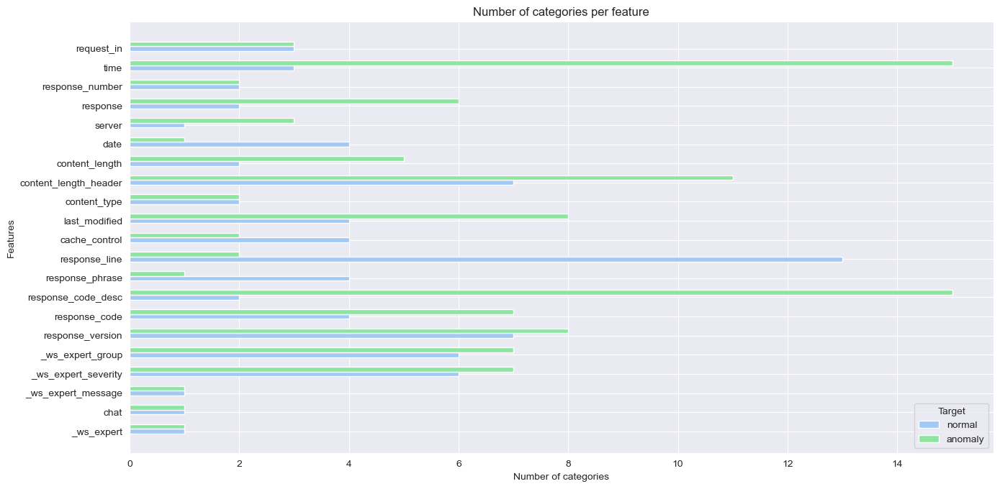

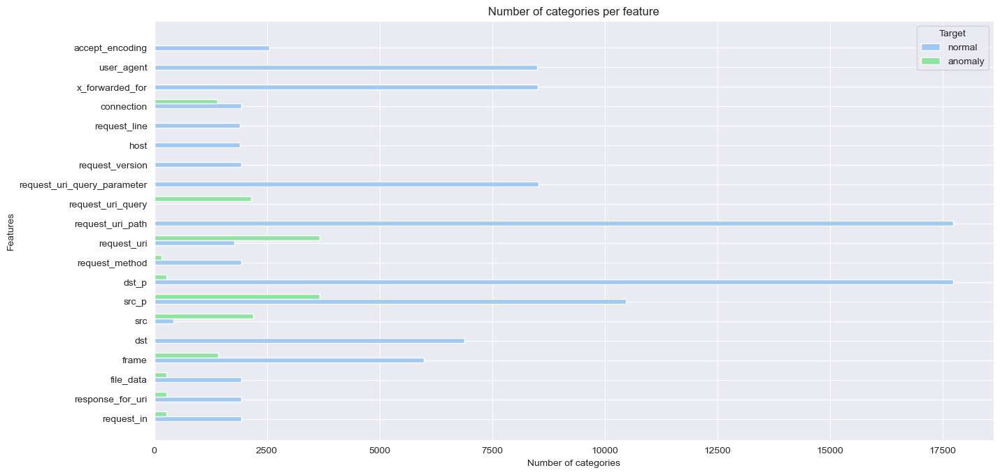

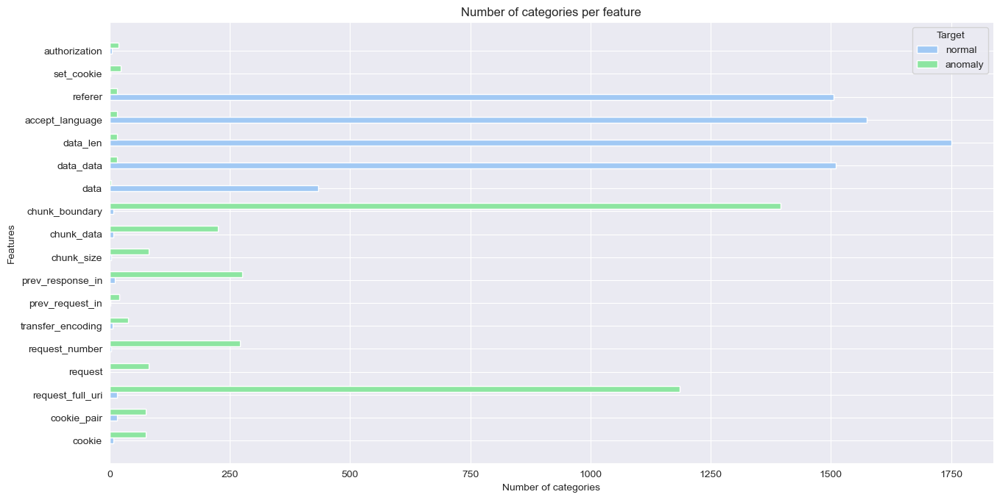

In [3]:
def distribution(i,n,data_n,data_a):
    d1 = [len(data_n[col].unique()) for col in data_n.columns]
    d2 = [len(data_a[col].unique()) for col in data_a.columns]
    
    d1_med = mediann(d1)
    d2_med = mediann(d2)
    d1_1,d1_2,d1_3,d2_1,d2_2,d2_3 = split(d1,d2,d1_med,d2_med)
    data = [(d1_1,d2_1),(d1_2,d2_2),(d1_3,d2_3)]
    inx = [0,len(d1_1)-1, len(d1_1)+len(d1_2)]
    ind = [len(data[0][0]),len(d1_1)+len(d1_2)-1,len(d1)-1,len(d1_1)+len(d1_2)-1]
    
    for i in range(3):
        sns.set_style('darkgrid')
        sns.color_palette('pastel')
        X = np.arange(len(data_a.columns))
        fig = plt.figure(figsize=(12,6))
        ax = fig.add_axes([0,0,1,1])
        ax.barh(X[inx[i]:ind[i]] + 0.00,data[i][0],0.25, color= sns.color_palette('pastel')[0],label='normal')
        ax.barh(X[inx[i]:ind[i]] + 0.25, data[i][1], 0.25,color= sns.color_palette('pastel')[2],label='anomaly')
        ax.set_yticks(X[inx[i]:ind[i]], data_n.columns[inx[i]:ind[i]])
        ax.legend(title='Target')
        plt.xlabel('Number of categories')
        plt.ylabel('Features')
        plt.title('Number of categories per feature')
    
def mediann(lst):
    n = len(lst)
    s = sorted(lst)
    return np.median(lst)

def split(d1,d2,d1_med,d2_med):
    d1_1 = []
    d1_2 = []
    d1_3 = []
    d2_1 = []
    d2_2 = []
    d2_3 = []
    if len(d1) > len(d2):
        index = d2
    else:
        index = d1
    for i in range(len(index)):
        if d1[i] <= d2_med and d2[i] <= d2_med:
            d1_1.append(d1[i])
            d2_1.append(d2[i])
        
        elif d1[i] <= np.mean(d1) and d2[i] <= np.mean(d1):
            d1_3.append(d1[i])
            d2_3.append(d2[i])
        else:
            d1_2.append(d1[i])
            d2_2.append(d2[i])
    return d1_1,d1_2,d1_3,d2_1,d2_2,d2_3



distribution(0,len(data_n),data_n,data_a)


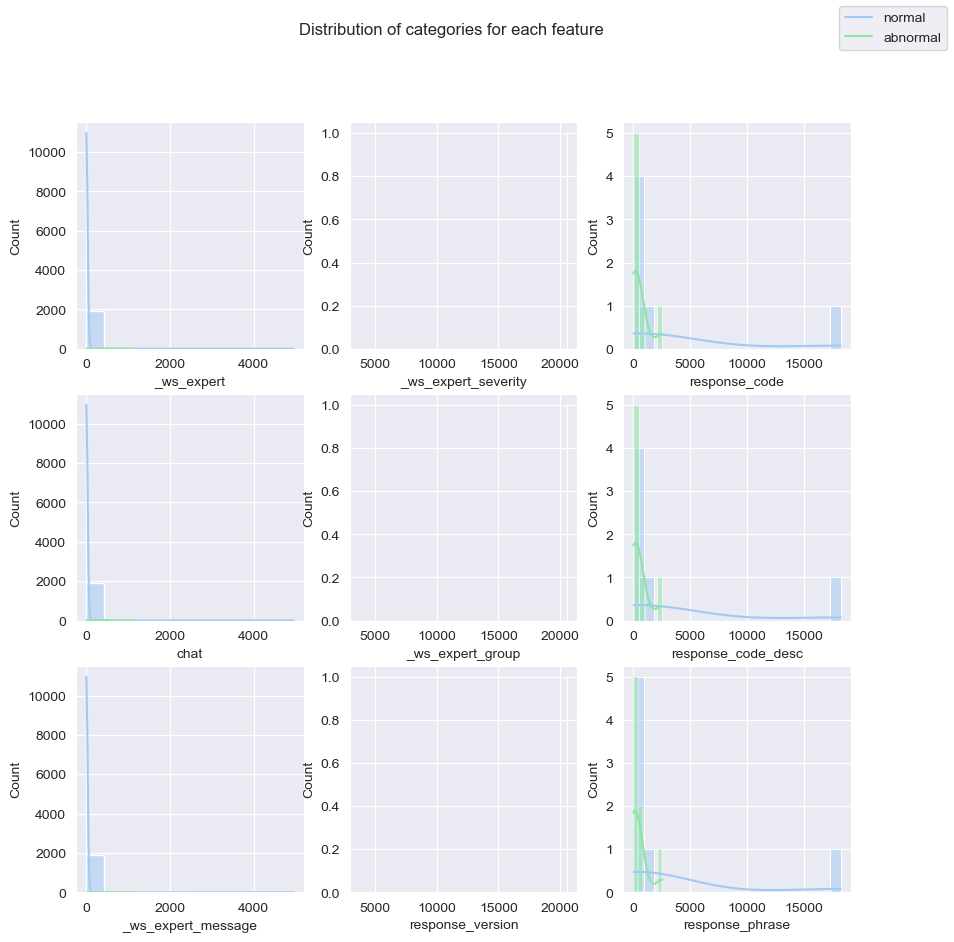

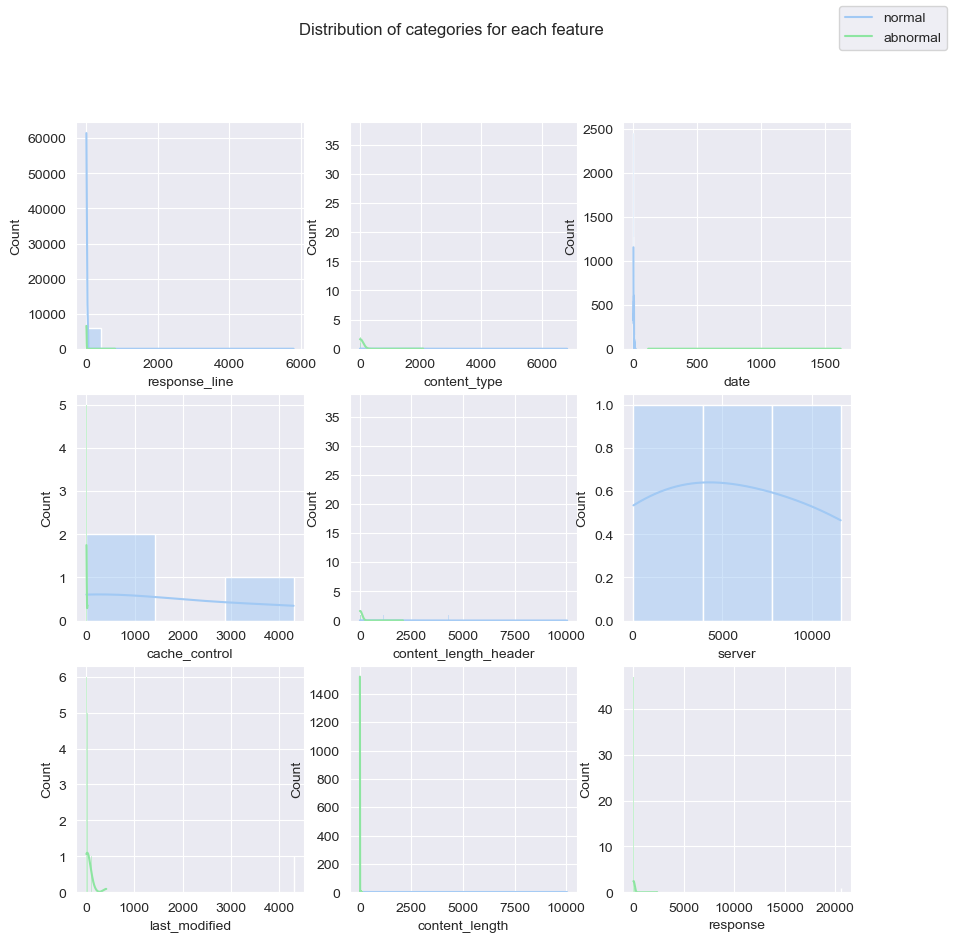

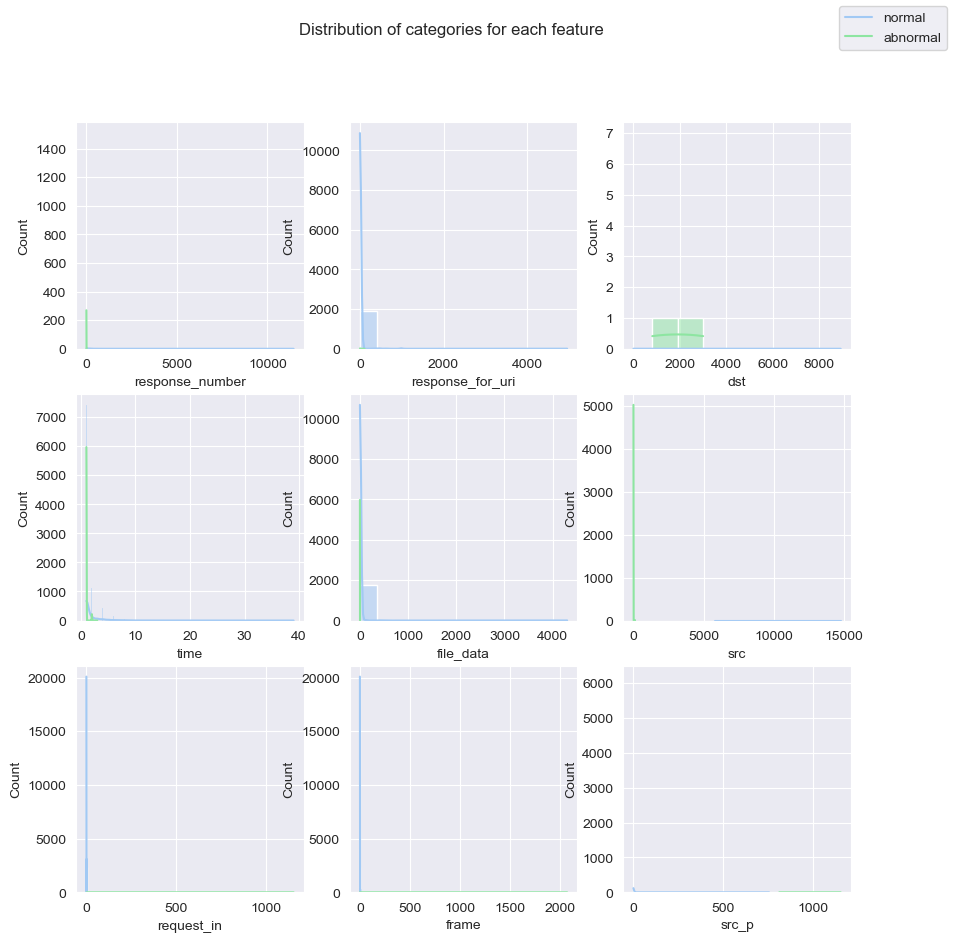

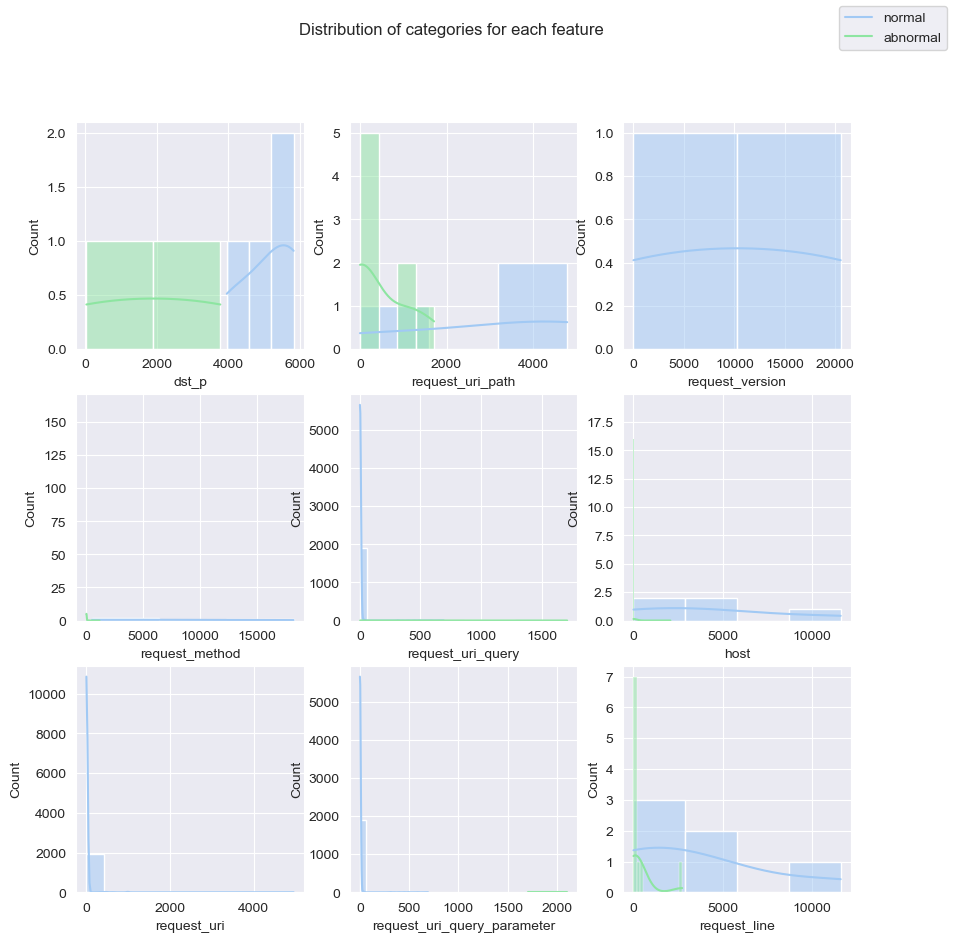

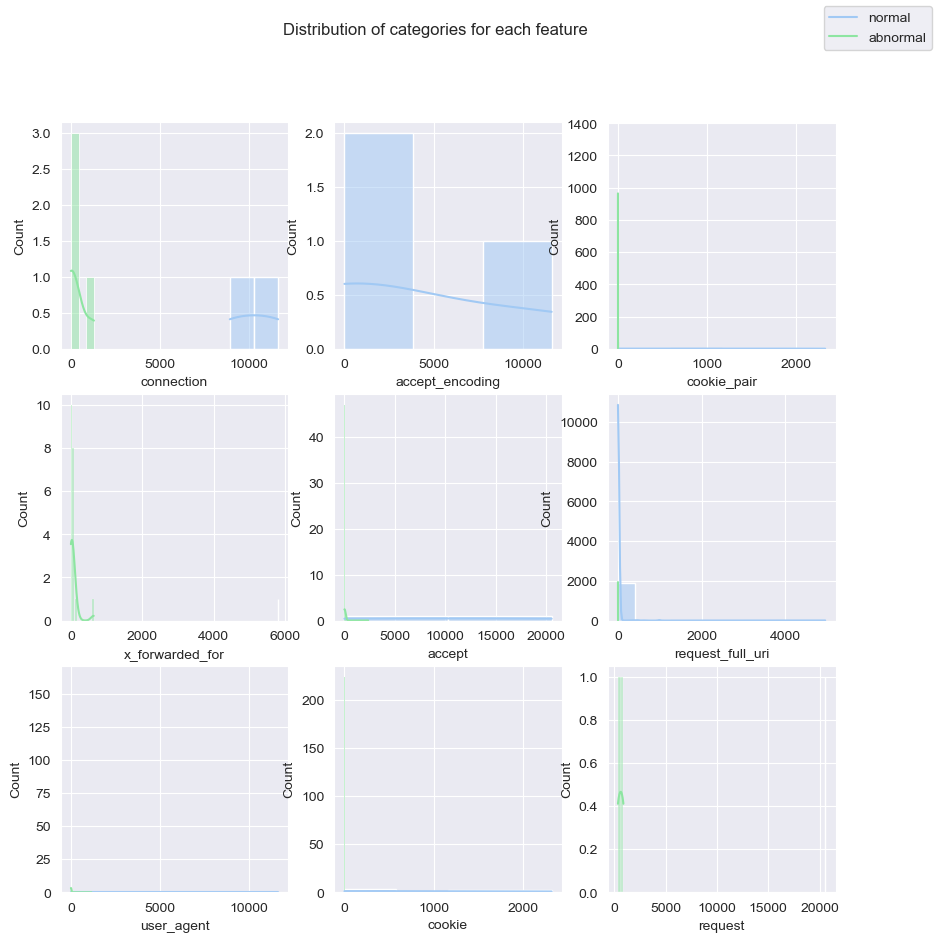

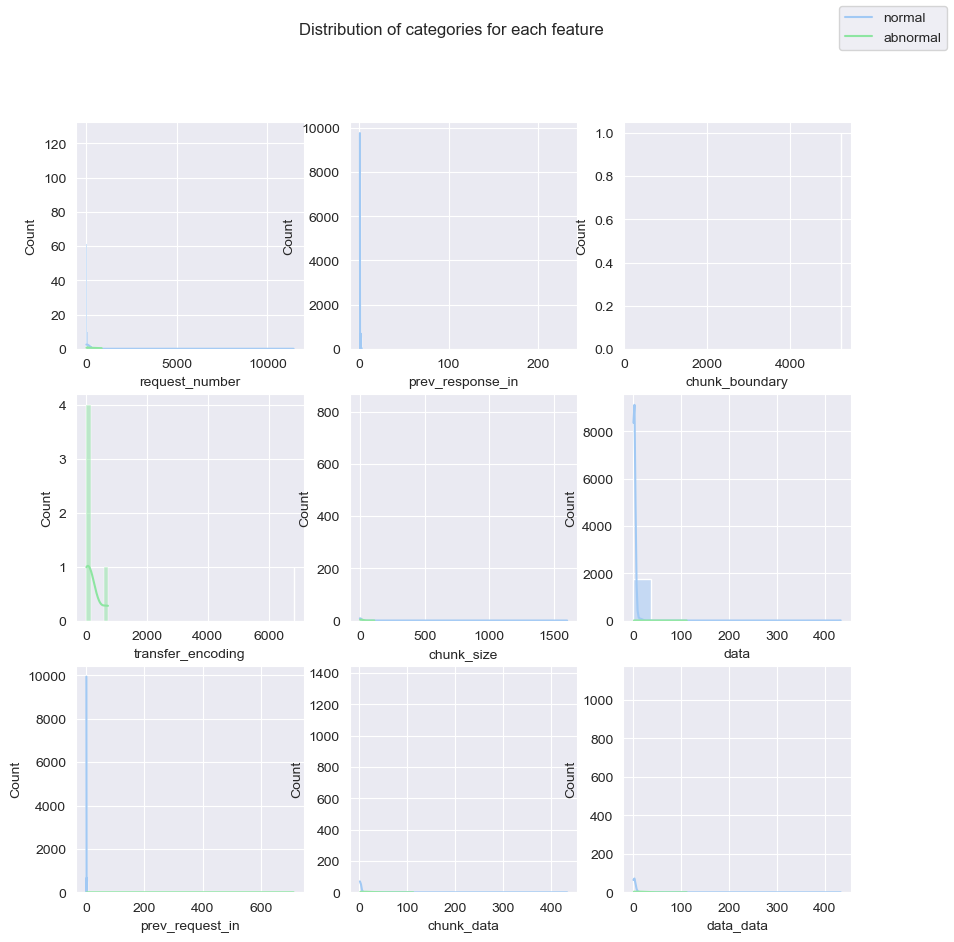

In [4]:
from scipy.stats import rankdata, norm
        
def visualise_distribution(data_n,data_a):
    for m in range(6):
        fig, axs = plt.subplots(3,3, figsize=(10,10))
        count=[0,9,18,27,36,45][m]
        for j in range(3):
            for i in range(3):
                sns.histplot(data_n[data_n.columns[count]].value_counts(),kde=True, color=sns.color_palette('pastel')[0], ax=axs[i,j],label='normal',legend=True)
                sns.histplot(data_a[data_a.columns[count]].value_counts(),kde=True,   color=sns.color_palette('pastel')[2], ax=axs[i,j],label='abnormal',legend=True)
                count+=1

        fig.suptitle('Distribution of categories for each feature')
        fig.legend(['normal','abnormal'])
        plt.show()
visualise_distribution(data_n,data_a)

None of my features seem to be normal distributed, but the distribution for anomalies and for normal behaviour do look significantly different.

## 2.1 Visualising NANS and the union of features between the labels

,NAN N,feat N,total N,NAN A,feat A,total A
request_uri_path,11459,9084,20543,3698,110,3808
request_uri_query,11459,9084,20543,3698,110,3808
request_uri_query_parameter,11459,9084,20543,3698,110,3808
request_version,0,20543,20543,0,3808,3808
host,1,20542,20543,0,3808,3808
request_line,1,20542,20543,0,3808,3808
connection,0,20543,20543,0,3808,3808
x_forwarded_for,14744,5799,20543,2997,811,3808
user_agent,1,20542,20543,0,3808,3808
accept_encoding,8917,11626,20543,3709,99,3808


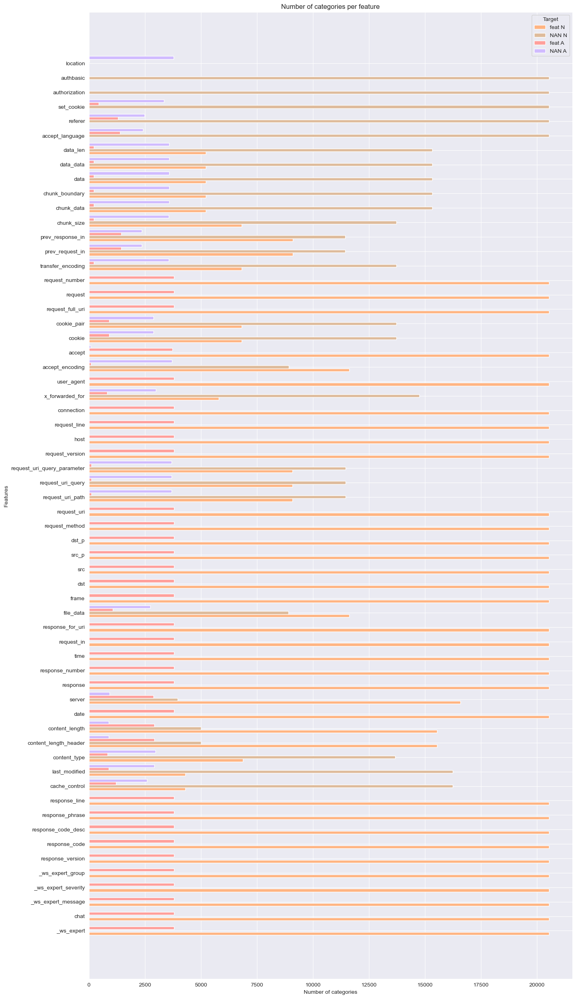

In [5]:
def visualizing_overlap_and_NANS(data_n,data_a):
    
    df = {}

    for col in data_n.columns:
        vals = [sum(data_n[col].isna()),len(data_n[col]) - sum(data_n[col].isna()), len(data_n[col])]
        
        if col in data_a.columns:     
            df[col] = vals
        else:
            df[col] = vals + [0,0,0]
    for col in data_a.columns:
        vals = [sum(data_a[col].isna()),len(data_a[col]) - sum(data_a[col].isna()), len(data_a[col])]
        
        if col not in df.keys():
            df[col] = [0,0,0] + vals
        else:
            df[col] += vals
    
    df1 =df
    df = pd.DataFrame(df,index=['NAN N','feat N','total N','NAN A','feat A','total A']).T
    display(df[30:])
    plotbar(df.values[:,1],df.values[:,0],df.values[:,4],df.values[:,3],df1.keys(),size=[12,24])
    
def plotbar(a,b,c,d,names,size=[12,6]):
    sns.set_style('darkgrid')
    sns.color_palette('pastel')
    X = np.arange(len(a))
    fig = plt.figure(figsize=size)
    ax = fig.add_axes([0,0,1,1])
    ax.barh(X -0.2,a,0.2, color= sns.color_palette('pastel')[1],label='feat N')
    ax.barh(X + 0.0,b, 0.2,color= sns.color_palette('pastel')[5],label='NAN N')
    ax.barh(X + 0.2,c,0.2, color= sns.color_palette('pastel')[3],label='feat A')
    ax.barh(X + 0.4,d, 0.2,color= sns.color_palette('pastel')[4],label='NAN A')
    ax.set_yticks(X, names)
    ax.legend(title='Target')
    plt.xlabel('Number of categories')
    plt.ylabel('Features')
    plt.title('Number of categories per feature')
        
visualizing_overlap_and_NANS(data_n, data_a)

We can see from these results that there is little overlap yet in the dataset, there are some features that are simply not present in the anomaly dataset 
and some features that are only present in the dataset. These are: in Anomaly dataset: location and _ws_string_trailing_stray_characters.
In normal they are authbasic and authorization. From this we can gather that these might be important. So maybe we do not want to take them out. 
Right now the datasets are still uneven, the anomolous dataset is way bigger than the normal dataset. moreover, we do not know which anomalies are represented exactly. We will need to look at that aswell.


When looking at this data it looks like I will need to add a data regularizer later on, to attribute the features that are a lot more present than the other classes less power, will need to see how this goes.. Otherwise it might overfit on the data. But need to do this by creating some heatmaps after running a model.

# 3. Preprocessing the data

In [46]:
import copy
import math

class Data_Preprocess():
    '''
    '''
    def __init__(self, data_n,data_a, health=False, specific = [], cosine = False, to_keep = [], continuous = [], categorical = []):
        self.to_keep = to_keep
        self.data_n = data_n
        self.data_a = data_a
        
    def remove_unessecary_data(self, data_n, data_a,data_remove):
        '''remove data that has no changing values or needs to be removed'''
        data = [data_n,data_a]
        for i in range(len(data)):
            data[i] = data[i].fillna(0)

            for col in data[i].columns:
                if col in data_remove or len(data[i][col].value_counts()) == 1:
                    print('dataset', i, 'removed', col,'with only',len(data[i][col].value_counts()), 'specific values')
                    data[i].pop(col)

        return data[0], data[1]



    def even_dataset(self, data_n,data_a):
        '''create even datasets and remove columns that are not present in either one'''
        if len(data_n) > len(data_a):
            data_n = data_n.sample(n=len(data_a))

        else:
            data_a = data_a.sample(n=len(data_n))
        return data_n,data_a


    def cosine_similarity(self, df):
        '''calculate cosine similarity of all the features'''
        print(df.columns)
        feats = df.columns
        cos_sim_a = {}
        for feat in range(len(feats)):
            for feat2 in range(len(feats)):
                if feat != feat2:
                    cos_sim = (df[feats[feat]] @ df[feats[feat2]].T) / (np.linalg.norm(df[feats[feat]])* np.linalg.norm(df[feats[feat2]]))
                    if (feats[feat2],feats[feat]) not in cos_sim_a.keys():
                        cos_sim_a[feats[feat],feats[feat2]] = cos_sim 
        return cos_sim_a


    def remove_cosine_sim_high(self, cossim,data):
        '''remove features that have a high cosine similarity '''
        highest = {}
        removed = set()
        for key,value in cossim.items():
            if value >= 0.98:
                if key[0] not in highest:
                    highest[key[0]] = 1
                else:
                    highest[key[0]] += 1
                if key[1] not in highest:
                    highest[key[1]] = 1
                else:
                    highest[key[1]] += 1

        for key,value in cossim.items():
            if value >= 0.98 and key[1] not in removed and key[0] not in removed:
                if highest[key[0]] >= highest[key[1]]:
                    data.pop(key[1])
                    removed.add(key[1])
                else:
                    data.pop(key[0])
                    removed.add(key[0])
        print(removed)
        return data


    def specific_preprocessing(self, data):
        '''remove features specifically'''
        data_p_n = copy.deepcopy(data)
        data_p_n.cookie.fillna(data_p_n.set_cookie, inplace=True)

        for i in range(len(data['response_line'])):
            if data_p_n['response_line'][i][0] != 'x':
                data_p_n['response_line'][i] = 0
        return data_p_n

    def remove_specific_data(self, data):
        for i in range(2):
            for col in data[i].columns:
                if col not in self.to_keep:
                    data[i].pop(col)
        return data[0],data[1]


    def change_values(self, data, continuous, categorical):
        print('cont',continuous,'cat',categorical)
        for col in data.columns:
            if col in continuous: 
                data[col] = data[col].astype('float')
                print('string',col)
            elif col in categorical:
                print('num',col)
                data[col] = data[col].astype('str')
        return data

    def remove_health_calls(self):
        data_n1 = copy.deepcopy(self.data_n)
        data_a1 = copy.deepcopy(self.data_a)
        data_n2 = data_n1.where(data_n1['user_agent'] != 'kube-probe/1.25')
        data_a2 =  data_a1.where(data_a1['user_agent'] != 'kube-probe/1.25')
        data_n2 = data_n2.dropna()
        data_a2 = data_a2.dropna()
        return data_n2, data_a2
    

In [47]:
    
interesting_to_keep = set(('user_agent','response_code','response_line','cache_control','content_type' ,'content_length','date','server','time','file_data','dst','src','src_p','dst_p','request_method','request_uri','request_uri_query','x_forwarded_for','user_agent','cookie','transfer_encoding','referer','authorization','authbasic'))
data_remove = set(('_ws_expert', 'chat', '_ws_expert_message'))

data_p_n = specific_preprocessing(data_n)
data_p_a = specific_preprocessing(data_a)
data_n_e, data_a_e = remove_specific_data([data_p_n,data_p_a],interesting_to_keep)

data_n_p,data_a_p = remove_unessecary_data(data_p_n, data_p_a, data_remove)
data_n_e,data_a_e = even_dataset(data_n_p,data_a_p)
data_n_e_p,data_a_e_p = even_dataset(data_p_n,data_p_a)

data_n_e,data_a_e = remove_unessecary_data(data_n_e,data_a_e,[])
# print("Amount of data left:",data_n_e.shape,len(data_a_e))
# print(data_n_e)
data_n_e,data_a_e = remove_health_calls(data_n_e,data_a_e)


dataset 0 removed referer with only 1 specific values
dataset 0 removed authorization with only 1 specific values
dataset 0 removed authbasic with only 1 specific values


,response_code,response_line,cache_control,content_type,content_length,date,server,time,file_data,dst,src,src_p,dst_p,request_method,request_uri,request_uri_query,x_forwarded_for,user_agent,cookie,transfer_encoding
7816,200,0,0,0,0,"Thu, 20 Apr 2023 14:31:04 GMT",envoy,0.000707000,0,10.57.0.65,10.57.0.77,58974,15021,GET,/healthz/ready,0,0,kube-probe/1.25,0,0
7533,200,0,0,0,0,"Thu, 20 Apr 2023 14:29:02 GMT",0,0.001308000,0,10.57.0.65,10.57.0.77,47456,15020,GET,/app-health/ingress-controller/livez,0,0,kube-probe/1.25,0,0
6735,200,0,0,0,0,"Thu, 20 Apr 2023 14:22:52 GMT",0,0.003218000,0,10.57.0.65,10.57.0.77,34342,15020,GET,/app-health/proxy/livez,0,0,kube-probe/1.25,0,0
13838,200,0,0,0,0,"Thu, 20 Apr 2023 12:25:52 GMT",0,0.000903000,0,10.57.0.65,10.57.0.77,43640,15020,GET,/app-health/ingress-controller/livez,0,0,kube-probe/1.25,0,0
6321,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 14:19:41 GMT",istio-envoy,0.001607000,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,10.57.0.71,53718,8079,GET,/detail.html?id=6d62d909-f957-430e-8689-b5129c...,id=6d62d909-f957-430e-8689-b5129c0bb75e,77.248.109.175,python-requests/2.27.1,md.sid=s%3AeUL-SE2sgiuFXeojAxoY4dEiqmGuGVDW.G%...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10221,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 14:49:15 GMT",istio-envoy,0.002149000,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,10.57.0.71,43452,8079,GET,/detail.html?id=808a2de1-1aaa-4c25-a9b9-6612e8...,id=808a2de1-1aaa-4c25-a9b9-6612e8f29a38,77.248.109.175,python-requests/2.27.1,md.sid=s%3AkoAviqqrlBrr2VmvC78eBeBsqwXdZ_bP.5c...,0
19535,200,0,0,0,0,"Thu, 20 Apr 2023 13:08:52 GMT",0,0.001286000,0,10.57.0.65,10.57.0.77,54352,15020,GET,/app-health/ingress-controller/livez,0,0,kube-probe/1.25,0,0
20037,200,0,0,0,0,"Thu, 20 Apr 2023 13:12:44 GMT",envoy,0.000618000,0,10.57.0.65,10.57.0.77,51400,15021,GET,/healthz/ready,0,0,kube-probe/1.25,0,0
18871,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 13:03:44 GMT",istio-envoy,0.002123000,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,10.57.0.71,35812,8079,GET,/detail.html?id=819e1fbf-8b7e-4f6d-811f-693534...,id=819e1fbf-8b7e-4f6d-811f-693534916a8b,77.248.109.175,python-requests/2.27.1,md.sid=s%3AeUL-SE2sgiuFXeojAxoY4dEiqmGuGVDW.G%...,0


,response_code,response_line,cache_control,content_type,content_length,date,server,time,file_data,dst,src,src_p,dst_p,request_method,request_uri,request_uri_query,x_forwarded_for,user_agent,cookie,transfer_encoding
6321,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 14:19:41 GMT",istio-envoy,0.001607000,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,10.57.0.71,53718,8079,GET,/detail.html?id=6d62d909-f957-430e-8689-b5129c...,id=6d62d909-f957-430e-8689-b5129c0bb75e,77.248.109.175,python-requests/2.27.1,md.sid=s%3AeUL-SE2sgiuFXeojAxoY4dEiqmGuGVDW.G%...,0
5938,200,x-powered-by: Express,0,0,0,"Thu, 20 Apr 2023 14:08:46 GMT",istio-envoy,0.039446000,"[{""id"":""6d62d909-f957-430e-8689-b5129c0bb75e"",...",10.57.0.77,10.57.0.71,60344,8079,GET,/catalogue?tags=formal%2Csport%2Cbrown%2Cblack...,tags=formal%2Csport%2Cbrown%2Cblack%2Cgeek%2Cr...,77.248.109.175,python-requests/2.27.1,0,chunked
13773,200,0,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 12:25:19 GMT",istio-envoy,0.002262000,"<!DOCTYPE html> <html lang=""en""> <head> ...",77.248.109.175,10.57.0.77,51975,8000,GET,/detail.html?id=808a2de1-1aaa-4c25-a9b9-6612e8...,id=808a2de1-1aaa-4c25-a9b9-6612e8f29a38,0,python-requests/2.27.1,logged_in=koAviqqrlBrr2VmvC78eBeBsqwXdZ_bP; md...,0
17851,202,x-powered-by: Express,0,application/json,0,"Thu, 20 Apr 2023 12:55:53 GMT",istio-envoy,0.026119000,File Data: 0 bytes,10.57.0.77,10.57.0.71,56442,8079,DELETE,/cart/837ab141-399e-4c1f-9abc-bace40296bac,0,77.248.109.175,python-requests/2.27.1,logged_in=koAviqqrlBrr2VmvC78eBeBsqwXdZ_bP; md...,chunked
4710,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 13:59:21 GMT",istio-envoy,0.001630000,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,10.57.0.71,48416,8079,GET,/detail.html?id=808a2de1-1aaa-4c25-a9b9-6612e8...,id=808a2de1-1aaa-4c25-a9b9-6612e8f29a38,77.248.109.175,python-requests/2.27.1,md.sid=s%3AeUL-SE2sgiuFXeojAxoY4dEiqmGuGVDW.G%...,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8164,201,0,0,application/json,46,"Thu, 20 Apr 2023 14:33:40 GMT",istio-envoy,0.156558000,"{""id"": ""819e1fbf-8b7e-4f6d-811f-693534916a8b""}",77.248.109.175,10.57.0.77,54718,8000,POST,/cart,0,0,python-requests/2.27.1,md.sid=s%3AkoAviqqrlBrr2VmvC78eBeBsqwXdZ_bP.5c...,chunked
7156,200,x-powered-by: Express,0,0,0,"Thu, 20 Apr 2023 14:26:05 GMT",istio-envoy,0.041977000,"[{""id"":""6d62d909-f957-430e-8689-b5129c0bb75e"",...",10.57.0.77,10.57.0.71,37212,8079,GET,/catalogue?tags=formal%2Cgeek%2Cblue%2Cgreen%2...,tags=formal%2Cgeek%2Cblue%2Cgreen%2Cmagic%2Cbl...,77.248.109.175,python-requests/2.27.1,0,chunked
10221,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 14:49:15 GMT",istio-envoy,0.002149000,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,10.57.0.71,43452,8079,GET,/detail.html?id=808a2de1-1aaa-4c25-a9b9-6612e8...,id=808a2de1-1aaa-4c25-a9b9-6612e8f29a38,77.248.109.175,python-requests/2.27.1,md.sid=s%3AkoAviqqrlBrr2VmvC78eBeBsqwXdZ_bP.5c...,0
18871,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 13:03:44 GMT",istio-envoy,0.002123000,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,10.57.0.71,35812,8079,GET,/detail.html?id=819e1fbf-8b7e-4f6d-811f-693534...,id=819e1fbf-8b7e-4f6d-811f-693534916a8b,77.248.109.175,python-requests/2.27.1,md.sid=s%3AeUL-SE2sgiuFXeojAxoY4dEiqmGuGVDW.G%...,0


TypeError: cannot unpack non-iterable NoneType object

Removed the features that had only one specific value. This was donen for responses and requests seperatedly since they both have a lot of features that are not present in the other. We also evened out the dataset, so that we have the same number of calls in the normal dataset as the abnormal dataset. We also have a function checking the cosine similarity 


user agent erin houden 
body erin houden 
uid van inventory
domain knowledge aantoevoegen 

Have realised the the authentication is not present for the anomalies. But also almost not present for the normal, maybe because I did not create enough users.

In [ ]:
visualizing_overlap_and_NANS(data_n_e,data_a_e)

# 4. Adding extra features
adding time and request and response flow

In [48]:
import plotly.graph_objects as go
from collections import OrderedDict
import seaborn as sns
import random
import numpy as np
from collections import defaultdict

In [55]:
class APIflows2:
    def __init__(self,data):
        self.data = data
        self.flowdict = OrderedDict()
        self.paths = []
        self.flow()
        self.path_info()
    
    def flow(self):
        last = 0
        cate = cat_enc(self.data['request_uri'])
        frames = {}
        for i in range(len(self.data)):
            if math.isnan(float(self.data['prev_request_in'][i])):
                self.add_flow_to_dict(0,cate[i])

                frames[self.data['frame'][i]] = [((0,cate[i]))]
            else:
                idx = self.data[self.data['frame']==self.data['prev_request_in'][i]].index.values

                if len(idx) > 1:
                    idx = [idx.flat[np.abs(idx - last).argmin()]]
                elif len(idx) < 1 or idx > i:
                    frames[self.data['frame'][i]] = [((0,cate[i]))]
                    continue
                
                last= idx[0]
                idx = idx[0]
                self.add_flow_to_dict(cate[idx], cate[i])
                frames[self.data['frame'][idx]].append(((cate[idx],cate[i])))
                frames[self.data['frame'][i]] = frames[self.data['frame'][idx]] 
                del frames[self.data['frame'][idx]]
        self.paths = list(frames.values())


                    
                    
    def add_flow_to_dict(self,flow1,flow2):
        '''Checks whether the flow is from the same user (by comparing coockies) and adds 
            them to the flow dict and source and target lists
            
            ***input***
            flow1 & flow2: the flows of the first and second user            
            '''
        if ((flow1,flow2)) not in self.flowdict:
            self.flowdict[((flow1,flow2))] = 1

        else:
            self.flowdict[((flow1,flow2))] += 1
            
    def path_info(self):    
        '''Get the shortest and longest paths
            Also get which paths are taken most often'''
        self.shortest = self.paths
        self.shortest.sort(key=lambda l: (len(l), l))
        self.numbers = {}
        
        for i in range(len(self.paths)):
            if tuple(self.paths[i]) in list(self.numbers.keys()):
                self.numbers[tuple(self.paths[i])] += 1  
            
            else:    
                self.numbers[tuple(self.paths[i])] = 1



In [56]:
def cat_enc(col):
    '''encode one column into categorical encoding'''
    
    col = pd.factorize(col)[0] + 1
    return col

flows_a = APIflows2(data_a_e)
flows_n =  APIflows2(data_n_e)

KeyError: 'prev_request_in'

In [ ]:
def create_sankey(flows,n,lab,option='default'):
    '''creates sankey diagram according to option for flow
        *** input***
            flows - the object containing the dicts and lists of flows/paths
            n - the number of flows  you want visualised
            lab - the labels for each flow
            option - the option of what needs to be visualised
            
        *** Options ***
            longest - The longest n paths users have taken
            shortest - The shortest n paths users have taken
            most - The n paths users take most offten
            least - The n paths users take least often
            defualt - Visualising the most seen api calls made from on point to another
        '''
    if option == 'longest':
        longest = flows.shortest
        longest.sort(key=lambda l: (len(l), l),reverse=True)
        plot_sankey(longest[:n], lab, flows.numbers,n)

    elif option == 'shortest':
        shortest = flows.shortest
        shortest.sort(key=lambda l: (len(l), l))
        plot_sankey(shortest[:n], lab, flows.numbers,n)
        
    elif option == 'most':
        flow_dict = dict(sorted(flows.numbers.items(), key=lambda x:x[1],reverse=True))
        plot_sankey(list(flow_dict.keys())[:n],lab, flows.numbers,n)
        
    elif option == 'least':
        flow_dict = dict(sorted(flows.numbers.items(), key=lambda x:x[1]))
        plot_sankey(list(flow_dict.keys())[:n], lab, flows.numbers,n)
        
    else:
        flow_dict = dict(sorted(flows.flowdict.items(), key=lambda x:x[1],reverse=True))
        plot_sankey(list(flow_dict.keys())[:n],lab, flow_dict,n)
        
        
def plot_sankey(s,lab,flow_dict,n):
    '''Plot the sankey diagram
    *** Input ***
        s - the source for each vertex
        lab - the label for each node
        flow_dict - the dictionary with paths containing edges and values
        n - the number of paths
    '''
    
    color_pal = sns.color_palette("Spectral",n).as_hex()
    
    # sort so that the sankey diagram is visualised in the right order
    s.sort()
    # if a list is used, some changes are made to visualise the paths
    if type(s[0]) is list:
        v = [[flow_dict[tuple(x)]] * len(x) for x in s]
        v1 = []
        s1 = []
        for i in range(len(s)):
            s1 = s1 + s[i]
            v1 = v1 + v[i]
        s =s1
        v =v1
    
    # this is used when there is not path just edges
    else:
        v = [flow_dict[x] for x in s]

    # creating label names instead of numbers
    l = ['client'] + [lab[x][:12] for x in range(1,len(lab))]
    
    # the dictionary is filled with tuples, so again some changes need to be added to representation
    if type(s[0][0]) is tuple:
        s1 = []
        for i in range(len(s)):
            s1 = s1 + list(s[i])
        s = s1
    
    # creating the figure
    fig = go.Figure(go.Sankey(
        arrangement='snap',
        node=dict(
              label = l,
            line = dict(color = "black", width = 0.5),
            pad=15,
            thickness=20,
        ),
        link=dict(
            source = list(np.array(s)[:,0]) ,
            target = list(np.array(s)[:,1]),
            value= v,
        )
    ))

    fig.show()

In [57]:
num_dict = data_n['request_uri'].to_dict()
create_sankey(flows_n,20, num_dict,'default')
num_dict2 = data_a['request_uri'].to_dict()
create_sankey(flows_a,20, num_dict2,'default')

In [58]:
create_sankey(flows_n,1, num_dict,'longest')
create_sankey(flows_a,1, num_dict2,'longest')

In [14]:
create_sankey(flows_n,7, num_dict,'shortest')
create_sankey(flows_a,7, num_dict2,'shortest')

In [15]:
create_sankey(flows_n,50, num_dict,'most')
create_sankey(flows_a,20, num_dict2,'most')

In [16]:
create_sankey(flows_n,50, num_dict,'least')
create_sankey(flows_a,50, num_dict2,'least')

# 5. Preprocessed dataset assesment


In [59]:
def split_features1(data,encoding):
    '''the split of features that I want encoded a particular way'''
    encodings = {"one_hot":one_hot,"hash": hashing, "WoE":WoE_encoding,"freq":freq,"cat":categorical_encoding}
    not_count = ['authorization', 'authbasic', 'location', 'target']

    categorical_feats = ['user_agent','response_line','cache_control', 'content_length','server','file_data','dst','src','src_p','dst_p','request_method','request_uri','request_uri_query','x_forwarded_for','user_agent','cookie','transfer_encoding','referer','authorization','authbasic','content_type','response_code','date']
    numerical = ['time']
    print(data['time'])
    categorical_data = data
    print(categorical_data['target'])
    categorical_data = categorical_data.drop('time',axis=1)
    categorical_data = categorical_data.drop('target',axis=1)
    
    encoding_of_feats = encodings[encoding](categorical_data)
    new_data = encoding_of_feats
    new_data['time'] = data['time']
    new_data['target'] = data['target']
    return new_data
    
def data_f(data_a,data_n):
    '''add the normal and abnormal data together and add an extra column for targets'''
    
    data_a['target'] = [0 * i for i in range(len(data_a))]
    data_n['target'] = [i**0 for i in range(len(data_n))]
    data = pd.concat([data_n,data_a])
    
    data,_ = remove_unessecary_data(data,data,[])
    return data

data = data_f(data_a_e, data_n_e)

# print(len(data_n_e),len(data_a_e))
# visualise_distribution(data_n_e,data_a_e)

# distribution(i,len(data_n_e),data_n_e,data_a_e)


In [60]:
def data_tabling(data):
    '''Displays a pandas dataframe that shows the number of different classes in each feature, 
    the average amount that the same feature is seen, the minimum amount that one of the classes of the feature is seen,
    and the maximum amount that the class of a feature is seen
    This gives us insight in which classes are used a lot within each feature'''
    max_n = []
    min_n = []
    avg_n = []
    classes_n = []
    total_n = []
    data = [data[: int(len(data)/2)], data[int(len(data)/2):]]
    for i in range(2):
        # the amount of times a feature class is present in the data
        feature_classes = [len(data[i][column].unique()) if len(data[i][column].unique()) != 0 else [0] for column in data[i].columns]
        feature_numbers = [data[i][column].value_counts() if len(data[i][column].value_counts()) != 0 else [0] for column in data[i].columns]

        max_n.append([max(x) for x in feature_numbers])
        min_n.append([min(x) for x in feature_numbers])
        avg_n.append([np.mean(x) for x in feature_numbers])
        classes_n.append([x for x in feature_classes])
        total_n.append([sum(x) for x in feature_numbers])
    
    names = ['Features','Max. cat normal', 'Min. cat. normal','Avg. cat. normal','Amount of Categories normal','Total calls normal','Max. cat. abnormal', 'Min. cat. abnormal','Avg. cat. abnormal','Amount of Categories abnormal','Total calls abnormal']
    
    columns = [[data[0].columns[i], max_n[0][i], min_n[0][i], avg_n[0][i], classes_n[0][i],total_n[0][i],max_n[1][i], min_n[1][i], avg_n[1][i], classes_n[1][i],total_n[1][i]] for i in range(len(data[0].columns))] 
    df = pd.DataFrame(columns, columns=names)
#     display(df)
    return(df)
data_tabling(data)

,Features,Max. cat normal,Min. cat. normal,Avg. cat. normal,Amount of Categories normal,Total calls normal,Max. cat. abnormal,Min. cat. abnormal,Avg. cat. abnormal,Amount of Categories abnormal,Total calls abnormal
0,response_code,3378,3,634.666667,6,3808,2542,2,544.000000,7,3808
1,response_line,2762,1046,1904.000000,2,3808,3003,805,1904.000000,2,3808
2,cache_control,2985,823,1904.000000,2,3808,2595,341,1269.333333,3,3808
3,content_type,2506,1,952.000000,4,3808,2974,6,253.866667,15,3808
4,content_length,1850,1,380.800000,10,3808,2088,2,50.105263,76,3808
5,date,7,1,1.337079,2848,3808,99,1,3.210793,1186,3808
6,server,2169,6,952.000000,4,3808,1620,116,952.000000,4,3808
7,time,8,1,1.291723,2948,3808,16,1,1.733273,2197,3808
8,file_data,1633,1,5.274238,722,3808,2744,2,22.666667,168,3808
9,dst,1633,1,634.666667,6,3808,2072,1,544.000000,7,3808


We can see from this table and the weight of evidence values below, that there are quite a lot of features that have very different categories. This means that when encoding the features into for example one hot encodings, this would mean very different vectors for either. For hasing encoding it will be the same. Categorical and frequency this will also be the case. However, is this a problem..? I honestly do not know. Since it still depends on the conditional relations between these values. It might overfit on values that are different, but that could aslo be the final conclusion on telling them apart.

I need to look into what this means. 

For now I would assume that the least telling features are the ones that are present once in a blue moon in either the "good" or the "bad" data

# 6. Feature Encodings

In [61]:
from category_encoders import *

def one_hot(data):
    '''encode full dataframe in one hot encoding'''
    
    one_hot_enc = pd.get_dummies(data)
    return one_hot_enc

def hashing(data):
    '''encode full '''
    enc = HashingEncoder().fit(data)
    numeric_dataset = enc.transform(data)
    return numeric_dataset

def WoE_encoding(data, not_count):
    '''weight of evidence encoding'''
    
    df = {}
    for col in data.columns:
        # calculate the WoE of each category of each feature, leave some of the data out, if it is not existent in both.
        if col not in not_count:
            woe_iv_dict = {}
            
            # create multi-index dataframe to better handle the indexing for this.
            feat_num2 =  data.groupby(col,as_index=False)['target'].value_counts()
            s = pd.Series(list(feat_num2['count']), index= pd.MultiIndex.from_tuples(list(zip(*[list(feat_num2['target']),list(feat_num2[col])])), names=["first", "second"]))
            dicty = dict(s)

            for cat in feat_num2[col]:
                # check if both normal and anomalous data is present, if not fill in 0 for this.
                if (1,cat) not in dicty or (0,cat) not in dicty:
                    if (1,cat) in dicty:
                         woe, IV = WoE(s.loc[1,cat],0,s[1].sum(),s[0].sum())
                    elif (0, cat) in dicty:
                         woe, IV = WoE(0,s.loc[0,cat],s[1].sum(),s[0].sum())
                else:
                    woe, IV = WoE(s.loc[1,cat],s.loc[0,cat],s[1].sum(),s[0].sum())
                    
                woe_iv_dict[cat] = [woe,IV]

                df['total_'+str(col)] = [sum([x[0] for x in list(woe_iv_dict.values())]), sum([x[1] for x in list(woe_iv_dict.values())])]    
        df1 = pd.DataFrame.from_dict(woe_iv_dict)
    df = pd.DataFrame.from_dict(df,orient='index',columns=['total_WoE','total_IV'])
    display(df)

    return df
        

def WoE(x1,x2,tot1,tot2):
    '''calculate the WoE for the categories in a feature'''
    #change prop in second part as well
    
    if x1 == 0 or x2 ==0:
        prop_g = (x1 + 0.5) /tot1
        prop_b = (x2 + 0.5) /tot2  
    else:
        prop_g = x1 / tot1
        prop_b = x2 / tot2
    
    woe = np.log(prop_g / prop_b)

    IV = woe * (prop_g - prop_b)
    return woe, IV


def freq(data):
    '''encode full dataframe in frequency encoding'''
    enc = CountEncoder().fit(data)
    numeric_dataset = enc.transform(data)
    return numeric_dataset


def categorical_encoding(df):
    '''encode full dataframe as categorical encoding'''
    
    df = copy.deepcopy(df)
    for col in df.columns:
        df[col] = pd.factorize(df[col])[0] + 1
    return df

not_count = ['authorization', 'authbasic', 'location', 'target']
woe_df = WoE_encoding(data, not_count)
freq(data)

,total_WoE,total_IV
total_response_code,-8.115150,2.784948
total_response_line,0.178230,0.021869
total_cache_control,-6.444315,0.599520
total_content_type,-44.473583,3.870148
total_content_length,-185.481961,2.364336
total_date,1826.629668,4.411252
total_server,-3.157474,0.155943
total_time,593.702477,1.871056
total_file_data,539.297597,3.031309
total_dst,-5.868470,15.737938


,response_code,response_line,cache_control,content_type,content_length,date,server,time,file_data,dst,...,dst_p,request_method,request_uri,request_uri_query,x_forwarded_for,user_agent,cookie,transfer_encoding,target,referer
7816,5920,5765,5580,5480,3938,1,2094,5,4377,1633,...,2094,7159,2094,5807,5759,3705,4956,6113,1,6305
7533,5920,5765,5580,5480,3938,1,1611,2,4377,1633,...,1611,7159,411,5807,5759,3705,4956,6113,1,6305
6735,5920,5765,5580,5480,3938,2,1611,1,4377,1633,...,1611,7159,404,5807,5759,3705,4956,6113,1,6305
13838,5920,5765,5580,5480,3938,2,1611,6,4377,1633,...,1611,7159,411,5807,5759,3705,4956,6113,1,6305
6321,5920,1851,1695,1296,825,2,3789,1,825,1046,...,1857,7159,74,74,1046,2172,382,6113,1,6305
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3803,656,5765,1695,5480,1805,99,3789,3,4377,887,...,2054,7159,30,5807,5759,1247,713,6113,0,60
3804,656,1851,1695,5480,1805,99,3789,13,4377,811,...,1857,7159,30,5807,811,1247,713,6113,0,60
3805,656,5765,1695,5480,1805,99,3789,7,4377,887,...,2054,7159,30,5807,5759,1247,713,6113,0,60
3806,656,1851,1695,5480,1805,99,3789,3,4377,811,...,1857,7159,30,5807,811,1247,713,6113,0,60


|Information Value (IV) |  Predictive Power |\
-------------------------------------------------\
|< 0.02 | useless for prediction|\
|0.02 to 0.1 | weak predictor|\
|0.1 to 0.3 | medium predictor|\
|0.3 to 0.5 | strong predictor|\
|> 0.5  | suspicious or too good to be true|

so the interesting features according to WoE 

In [62]:
def measure_predictor_value_woe(woe_df):
    strong_predictors = []
    weak_predictors = []
    medium_predictors = []
    suspicious = []
    useless = []
    very_suspicious = []
    for i, num in enumerate(woe_df['total_IV']):


        if num < 0.5 and num > 0.3:
            strong_predictors.append(woe_df.index[i])
        elif num < 0.1 and num > 0.02:
            weak_predictors.append(woe_df.index[i])
        elif num < 0.02:    
            useless.append(woe_df.index[i])
        elif num > 0.1 and num < 0.3:    
            medium_predictors.append(woe_df.index[i])
        elif num > 0.5 and num < 1:    
            suspicious.append(woe_df.index[i])
        elif num > 1:
            very_suspicious.append(woe_df.index[i])

    print('strong predictors', strong_predictors)
    print()
    print('medium predictors', medium_predictors)
    print()
    print('weak_predcitors', weak_predictors)
    print()
    print('useless', useless)
    print()
    print('suspicious', suspicious)
    print('very suspicious', very_suspicious)
  
measure_predictor_value_woe(woe_df)

strong predictors ['total_request_method']

medium predictors ['total_server']

weak_predcitors ['total_response_line', 'total_dst_p']

useless []

suspicious ['total_cache_control', 'total_transfer_encoding']
very suspicious ['total_response_code', 'total_content_type', 'total_content_length', 'total_date', 'total_time', 'total_file_data', 'total_dst', 'total_src', 'total_src_p', 'total_request_uri', 'total_request_uri_query', 'total_x_forwarded_for', 'total_user_agent', 'total_cookie', 'total_referer']


# 7. Train - Val - Test split

In [63]:
def split(data_n,data_a):
    '''split the data into 70-20-10'''
    
    train_n = data_n.sample(frac=0.70)
    train_a = data_a.sample(frac=0.70)
    int_n = data_n.drop(train_n.index)
    int_a = data_a.drop(train_a.index)
    val_n = int_n.sample(frac=0.2)
    val_a = int_a.sample(frac=0.2)
#     test_n = int_n.drop(val_n.index)
    test_a = int_a.drop(val_a.index)
    
    train = pd.concat([train_n,train_a], ignore_index=True)
#     validation = pd.concat([val_n,val_a], ignore_index=True)
#     test = pd.concat([val_n,val_a], ignore_index=True)
    return train

#     return train, validation, test
train = split(data_n_e,data_a_e)
print(train)


     response_code           response_line cache_control  \
0              200  x-powered-by: Express              0   
1              200                       0             0   
2              200                       0             0   
3              200                       0             0   
4              200                       0             0   
...            ...                     ...           ...   
5327           200                       0             0   
5328           404                       0      no-cache   
5329           404  x-powered-by: Express              0   
5330           200                       0             0   
5331           404  x-powered-by: Express              0   

                  content_type content_length                           date  \
0             application/json              0  Thu, 20 Apr 2023 14:52:31 GMT   
1                            0              0  Thu, 20 Apr 2023 13:32:13 GMT   
2                            0         

# 8. ML techniques for feature selection

In [91]:
from kmodes.kprototypes import KPrototypes
from kmodes.kmodes import KModes
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import GridSearchCV
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression
from sklearn.feature_selection import SelectKBest, chi2
from sklearn.feature_selection import SequentialFeatureSelector


def clustering(data_m, data):
    
    # k-prototypes
    # k-means with one-hot encoding
    # normalise continuous data (numerical), so that one continuous data is not seen as more important than another. But only one continuous data so for now it does not have to\
    
    kmode = KModes(n_clusters=2, init = "random", verbose=1)
    clusters = kmode.fit_predict(data_m)
    #join data with labels 
    labels = pd.DataFrame(clusters)
    
    data['Cluster_Labels'] = kmode.labels_
    for col in data.columns:
        print(col)
        if col != 'time' or col != 'date':
            plt.subplots(figsize = (15,5))
            sns.countplot(x='Cluster_Labels',hue=col, data = data)
            plt.show()


    display(data)
    
#     features = []
#     for i, col in enumerate(data.columns):
#         feats = []
#         for idx in data[col]:
#             if data.iloc(Cluster_Labels, idx)  == data.iloc()
            
    accuracy = 
    


    
def logistic_regression(df):
    y = df['target']
    X = df.drop('target', axis=1)
    
    model = LogisticRegression()

    # Use RFE to select the top 10 features
#     rfe = RFE(model, n_features_to_select=10)
#     rfe.fit(X, y)
    scaler = StandardScaler()
#     X_std = scaler.fit_transform(X)

#     # Print the selected features
#     print(rfe.support_)
    sfs = SequentialFeatureSelector(model, scoring='accuracy',direction='forward')
    sfs.fit(X, y)
# Use SelectKBest to select the top 10 features
    selector = SelectKBest(chi2, k=10)
    X_new = selector.fit_transform(X, y)

    # Print the selected features
    print("this",selector.get_support())
    for i in range(len(selector.get_support())):
        if selector.get_support()[i] == True:
            print(df.columns[i])
    print(df.columns)

    # Standardize the train and test sample
#     scaler = StandardScaler()
#     X_std = scaler.fit_transform(X)
    
#     # Perform GridSearchCV to tune best-fit LR model
#     param = {'C': [10**-2,10**-1,10**0,10**1,10**2]}

#     lr_model = LogisticRegression(penalty='l1', solver='liblinear')
#     gs_model = GridSearchCV(estimator=lr_model, param_grid=param)
#     gs_model.fit(X_std, y)

#     # Train a LR model with best parameters
#     model = LogisticRegression(**gs_model.best_params_, penalty='l1', solver='liblinear')
#     model.fit(X_std, y)
    
#     coef = model.coef_[0]
#     imp_features = pd.Series(X.columns)[list(coef!=0)]
#     X_train = X[imp_features]
#     print("Redundant Feature Count:",sum(model.coef_[0]==0))
#     print("Redundant Feature Names:", list(pd.Series(X_train.columns)[list(coef==0)]))

def SVM():
    pass

def MCM():
    pass

def PCA():
    pass
 
def heatmap(data):
    corr = data.corr(method='spearman')
    # Generate a mask for the upper triangle
    print(corr)
    mask = np.zeros_like(corr, dtype=np.bool)
    mask[np.triu_indices_from(mask)] = True

    # Set up the matplotlib figure
    f, ax = plt.subplots(figsize=(20, 18))

    # Draw the heatmap with the mask and correct aspect ratio
    sns.heatmap(corr, mask=mask, cmap="YlGnBu", vmax=.30, center=0,
                square=True, linewidths=.5, cbar_kws={"shrink": .5})
    


cont ['time'] cat ['user_agent', 'response_line', 'cache_control', 'content_length', 'server', 'file_data', 'dst', 'src', 'src_p', 'dst_p', 'request_method', 'request_uri', 'request_uri_query', 'x_forwarded_for', 'user_agent', 'cookie', 'transfer_encoding', 'referer', 'authorization', 'authbasic', 'content_type', 'response_code', 'date']
num response_code
num response_line
num cache_control
num content_type
num content_length
num date
num server
string time
num file_data
num dst
num src
num src_p
num dst_p
num request_method
num request_uri
num request_uri_query
num x_forwarded_for
num user_agent
num cookie
num transfer_encoding
num referer


,response_code,response_line,cache_control,content_type,content_length,date,server,time,file_data,dst,...,request_uri,request_uri_query,x_forwarded_for,user_agent,cookie,transfer_encoding,target,referer,Cluster_Labels,Segment
7816,200,0,0,0,0,"Thu, 20 Apr 2023 14:31:04 GMT",envoy,0.000707,0,10.57.0.65,...,/healthz/ready,0,0,kube-probe/1.25,0,0,1,0,1,Second
7533,200,0,0,0,0,"Thu, 20 Apr 2023 14:29:02 GMT",0,0.001308,0,10.57.0.65,...,/app-health/ingress-controller/livez,0,0,kube-probe/1.25,0,0,1,0,1,Second
6735,200,0,0,0,0,"Thu, 20 Apr 2023 14:22:52 GMT",0,0.003218,0,10.57.0.65,...,/app-health/proxy/livez,0,0,kube-probe/1.25,0,0,1,0,1,Second
13838,200,0,0,0,0,"Thu, 20 Apr 2023 12:25:52 GMT",0,0.000903,0,10.57.0.65,...,/app-health/ingress-controller/livez,0,0,kube-probe/1.25,0,0,1,0,1,Second
6321,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 14:19:41 GMT",istio-envoy,0.001607,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,...,/detail.html?id=6d62d909-f957-430e-8689-b5129c...,id=6d62d909-f957-430e-8689-b5129c0bb75e,77.248.109.175,python-requests/2.27.1,md.sid=s%3AeUL-SE2sgiuFXeojAxoY4dEiqmGuGVDW.G%...,0,1,0,0,First
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3803,304,0,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000875,0,144.254.200.116,...,/css/owl.carousel.css,0,0,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,1,Second
3804,304,x-powered-by: Express,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000524,0,10.57.0.15,...,/css/custom.css,0,144.254.200.116,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,0,First
3805,304,0,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000739,0,144.254.200.116,...,/css/custom.css,0,0,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,1,Second
3806,304,x-powered-by: Express,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000818,0,10.57.0.15,...,/css/font-awesome.css,0,144.254.200.116,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,0,First


                    time    target  Cluster_Labels
time            1.000000  0.332491       -0.577501
target          0.332491  1.000000       -0.367089
Cluster_Labels -0.577501 -0.367089        1.000000


/var/folders/bc/h0tv3jhn5gn4b_fbv4x5pnbc0000gn/T/ipykernel_4183/1045430514.py:119: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.

/var/folders/bc/h0tv3jhn5gn4b_fbv4x5pnbc0000gn/T/ipykernel_4183/1045430514.py:122: DeprecationWarning:

`np.bool` is a deprecated alias for the builtin `bool`. To silence this warning, use `bool` by itself. Doing this will not modify any behavior and is safe. If you specifically wanted the numpy scalar type, use `np.bool_` here.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations



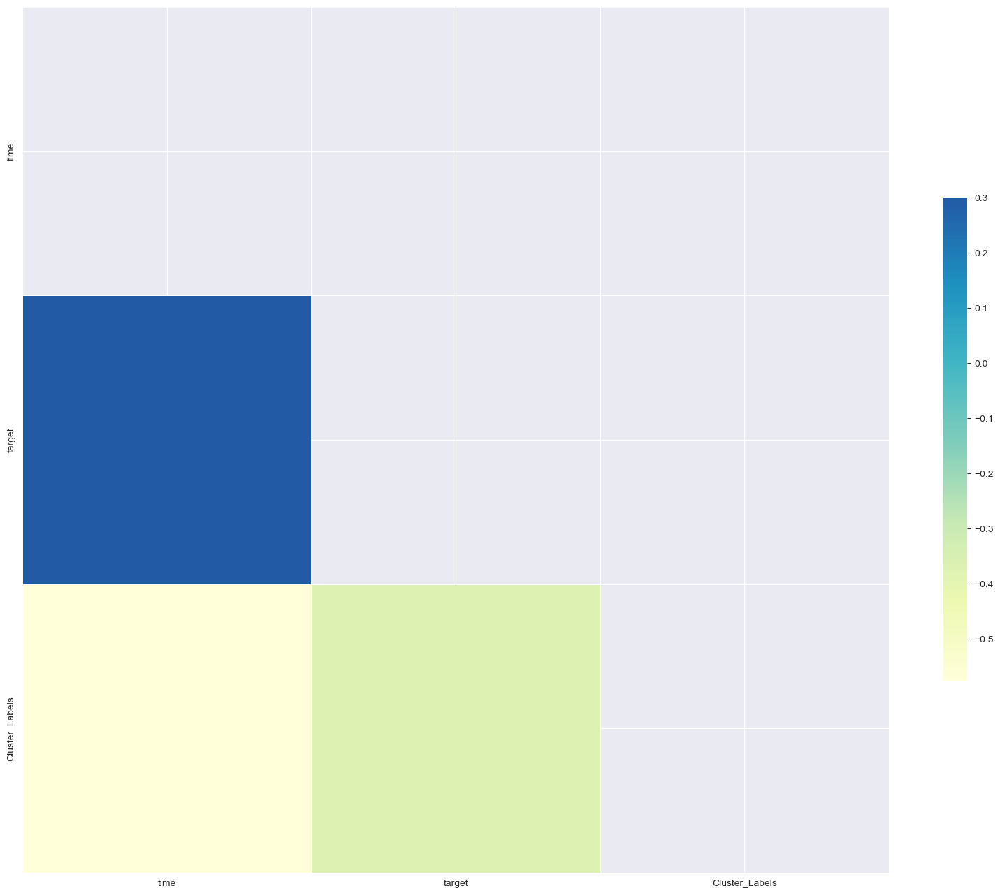

In [92]:
categorical_feats = ['user_agent','response_line','cache_control', 'content_length','server','file_data','dst','src','src_p','dst_p','request_method','request_uri','request_uri_query','x_forwarded_for','user_agent','cookie','transfer_encoding','referer','authorization','authbasic','content_type','response_code','date']
numerical = ['time']
data_c = change_values(data, numerical,categorical_feats)
data_matrix = data_c.to_numpy()
display(data_c)
heatmap(data_c)

cont ['time'] cat ['user_agent', 'response_line', 'cache_control', 'content_length', 'server', 'file_data', 'dst', 'src', 'src_p', 'dst_p', 'request_method', 'request_uri', 'request_uri_query', 'x_forwarded_for', 'user_agent', 'cookie', 'transfer_encoding', 'referer', 'authorization', 'authbasic', 'content_type', 'response_code', 'date']
num response_code
num response_line
num cache_control
num content_type
num content_length
num date
num server
string time
num file_data
num dst
num src
num src_p
num dst_p
num request_method
num request_uri
num request_uri_query
num x_forwarded_for
num user_agent
num cookie
num transfer_encoding
num referer
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 1856, cost: 69745.0
Run 1, iteration: 2/100, moves: 1162, cost: 67287.0
Run 1, iteration: 3/100, moves: 4, cost: 67287.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 337, c

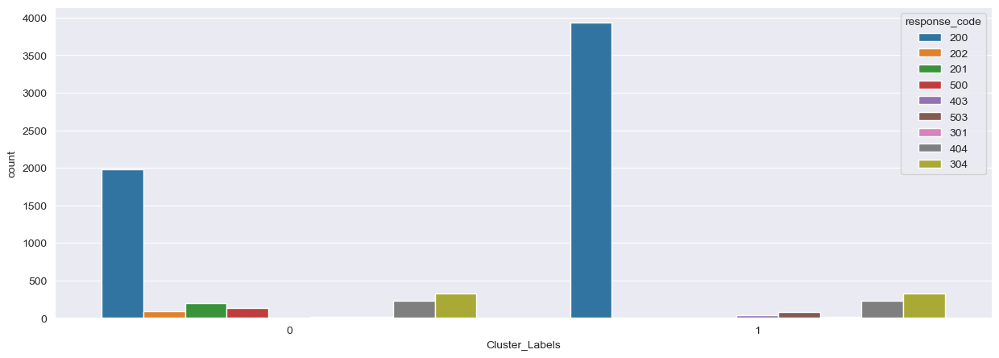

response_line


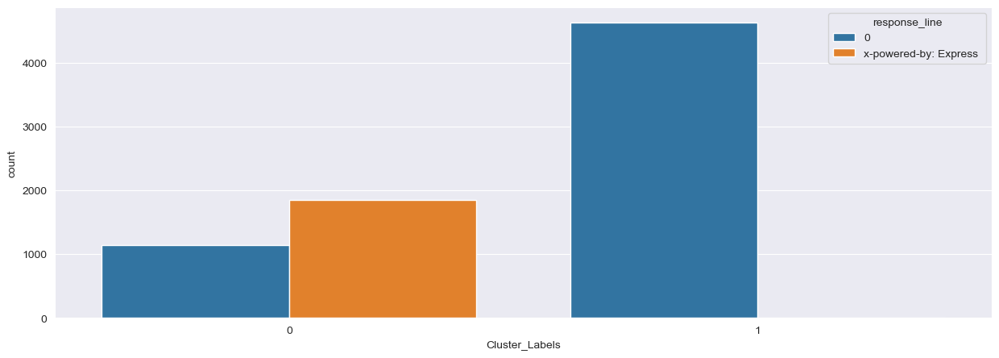

cache_control


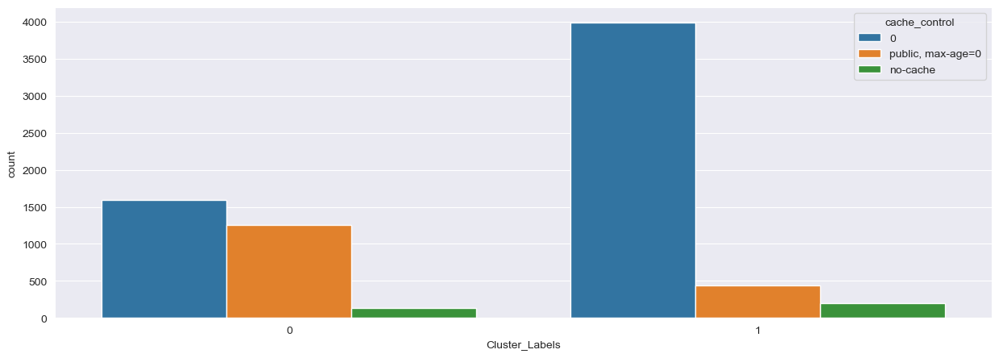

content_type


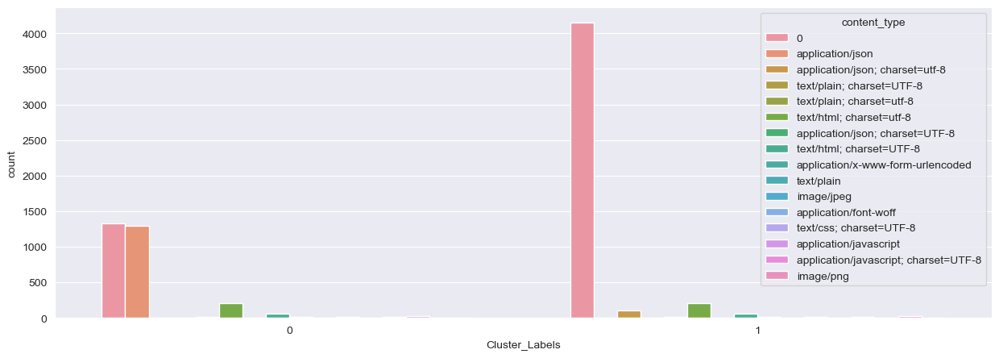

content_length


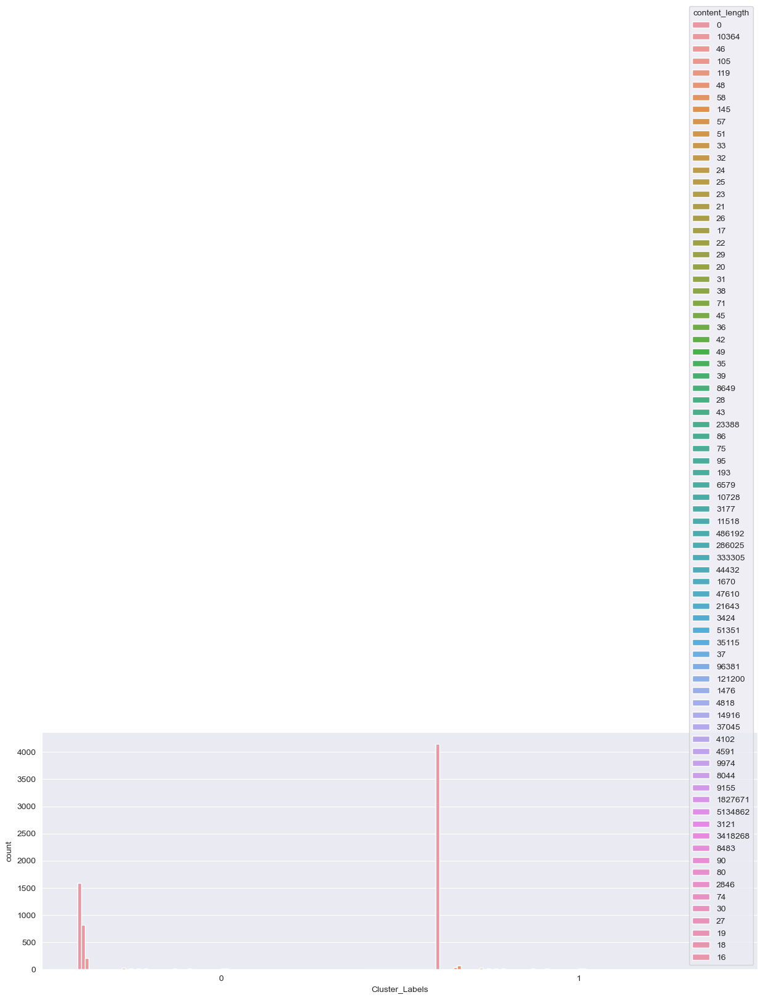

date


ValueError: Image size of 1225x79425 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1500x500 with 1 Axes>

server


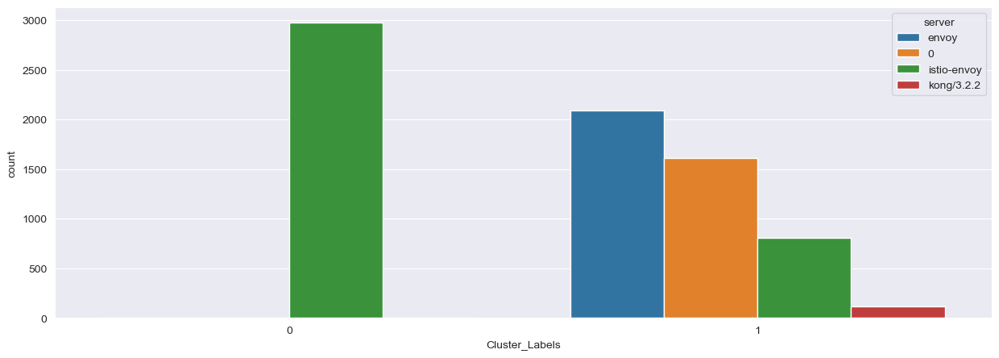

time


ValueError: Image size of 1225x85738 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1500x500 with 1 Axes>

file_data


/Users/cveenker/anaconda3/envs/thesis/lib/python3.11/site-packages/IPython/core/pylabtools.py:152: UserWarning:

Glyph 65533 (\N{REPLACEMENT CHARACTER}) missing from current font.



ValueError: 
/g,p=/^-ms-/,q=/-([\da-z])/gi,r=function(a,b){return b.toUpperCase()};n.fn=n.prototype={jquery:m,constructor:n,selector:"",length:0,toArray:function(){return d.call(this)},get:function(a){return null!=a?0>a?this[a+this.length]:this[a]:d.call(this)},pushStack:function(a){var b=n.merge(this.constructor(),a);return b.prevObject=this,b.context=this.context,b},each:function(a,b){return n.each(this,a,b)},map:function(a){return this.pushStack(n.map(this,function(b,c){return a.call(b,c,b)}))},slice:function(){return this.pushStack(d.apply(this,arguments))},first:function(){return this.eq(0)},last:function(){return this.eq(-1)},eq:function(a){var b=this.length,c=+a+(0>a?b:0);return this.pushStack(c>=0&&b>c?[this[c]]:[])},end:function(){return this.prevObject||this.constructor(null)},push:f,sort:c.sort,splice:c.splice},n.extend=n.fn.extend=function(){var a,b,c,d,e,f,g=arguments[0]||{},h=1,i=arguments.length,j=!1;for("boolean"==typeof g&&(j=g,g=arguments[h]||{},h++),"object"==typeof g||n.isFunction(g)||(g={}),h===i&&(g=this,h--);i>h;h++)if(null!=(e=arguments[h]))for(d in e)a=g[d],c=e[d],g!==c&&(j&&c&&(n.isPlainObject(c)||(b=n.isArray(c)))?(b?(b=!1,f=a&&n.isArray(a)?a:[]):f=a&&n.isPlainObject(a)?a:{},g[d]=n.extend(j,f,c)):void 0!==c&&(g[d]=c));return g},n.extend({expando:"jQuery"+(m+Math.random()).replace(/\D/g,""),isReady:!0,error:function(a){throw new Error(a)},noop:function(){},isFunction:function(a){return"function"===n.type(a)},isArray:Array.isArray||function(a){return"array"===n.type(a)},isWindow:function(a){return null!=a&&a==a.window},isNumeric:function(a){return a-parseFloat(a)>=0},isEmptyObject:function(a){var b;for(b in a)return!1;return!0},isPlainObject:function(a){var b;if(!a||"object"!==n.type(a)||a.nodeType||n.isWindow(a))return!1;try{if(a.constructor&&!j.call(a,"constructor")&&!j.call(a.constructor.prototype,"isPrototypeOf"))return!1}catch(c){return!1}if(l.ownLast)for(b in a)return j.call(a,b);for(b in a);return void 0===b||j.call(a,b)},type:function(a){return null==a?a+"":"object"==typeof a||"function"==typeof a?h[i.call(a)]||"object":typeof a},globalEval:function(b){b&&n.trim(b)&&(a.execScript||function(b){a.eval.call(a,b)})(b)},camelCase:function(a){return a.replace(p,"ms-").replace(q,r)},nodeName:function(a,b){return a.nodeName&&a.nodeName.toLowerCase()===b.toLowerCase()},each:function(a,b,c){var d,e=0,f=a.length,g=s(a);if(c){if(g){for(;f>e;e++)if(d=b.apply(a[e],c),d===!1)break}else for(e in a)if(d=b.apply(a[e],c),d===!1)break}else if(g){for(;f>e;e++)if(d=b.call(a[e],e,a[e]),d===!1)break}else for(e in a)if(d=b.call(a[e],e,a[e]),d===!1)break;return a},trim:k&&!k.call("\ufeff\xa0")?function(a){return null==a?"":k.call(a)}:function(a){return null==a?"":(a+"").replace(o,"")},makeArray:function(a,b){var c=b||[];return null!=a&&(s(Object(a))?n.merge(c,"string"==typeof a?[a]:a):f.call(c,a)),c},inArray:function(a,b,c){var d;if(b){if(g)return g.call(b,a,c);for(d=b.length,c=c?0>c?Math.max(0,d+c):c:0;d>c;c++)if(c in b&&b[c]===a)return c}return-1},merge:function(a,b){var c=+b.length,d=0,e=a.length;while(c>d)a[e++]=b[d++];if(c!==c)while(void 0!==b[d])a[e++]=b[d++];return a.length=e,a},grep:function(a,b,c){for(var d,e=[],f=0,g=a.length,h=!c;g>f;f++)d=!b(a[f],f),d!==h&&e.push(a[f]);return e},map:function(a,b,c){var d,f=0,g=a.length,h=s(a),i=[];if(h)for(;g>f;f++)d=b(a[f],f,c),null!=d&&i.push(d);else for(f in a)d=b(a[f],f,c),null!=d&&i.push(d);return e.apply([],i)},guid:1,proxy:function(a,b){var c,e,f;return"string"==typeof b&&(f=a[b],b=a,a=f),n.isFunction(a)?(c=d.call(arguments,2),e=function(){return a.apply(b||this,c.concat(d.call(arguments)))},e.guid=a.guid=a.guid||n.guid++,e):void 0},now:function(){return+new Date},support:l}),n.each("Boolean Number String Function Array Date RegExp Object Error".split(" "),function(a,b){h["[object "+b+"]"]=b.toLowerCase()});function s(a){var b=a.length,c=n.type(a);return"function"===c||n.isWindow(a)?!1:1===a.nodeType&&b?!0:"array"===c||0===b||"number"==typeof b&&b>0&&b-1 in a}var t=function(a){var b,c,d,e,f,g,h,i,j,k,l,m,n,o,p,q,r,s="sizzle"+-new Date,t=a.document,u=0,v=0,w=eb(),x=eb(),y=eb(),z=function(a,b){return a===b&&(j=!0),0},A="undefined",B=1<<31,C={}.hasOwnProperty,D=[],E=D.pop,F=D.push,G=D.push,H=D.slice,I=D.indexOf||function(a){for(var b=0,c=this.length;c>b;b++)if(this[b]===a)return b;return-1},J="checked|selected|async|autofocus|autoplay|controls|defer|disabled|hidden|ismap|loop|multiple|open|readonly|required|scoped",K="[\\x20\\t\\r\\n\\f]",L="(?:\\\\.|[\\w-]|[^\\x00-\\xa0])+",M=L.replace("w","w#"),N="\\["+K+"*("+L+")"+K+"*(?:([*^
                   ^
ParseFatalException: Unknown symbol: \da, found '\'  (at char 19), (line:1, col:20)

<Figure size 1500x500 with 1 Axes>

dst


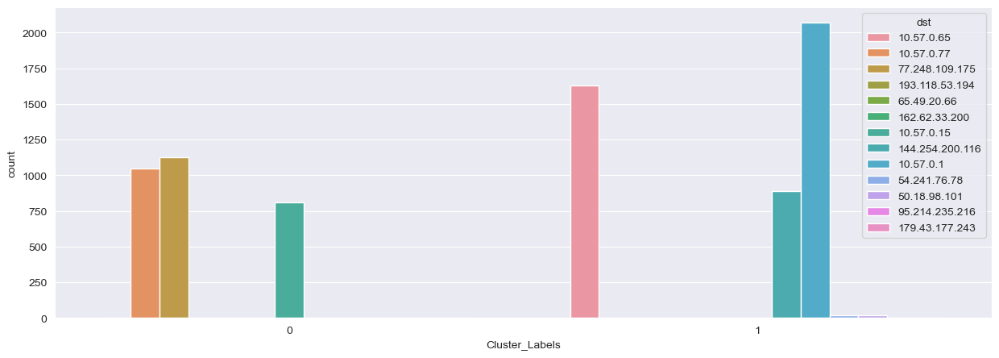

src


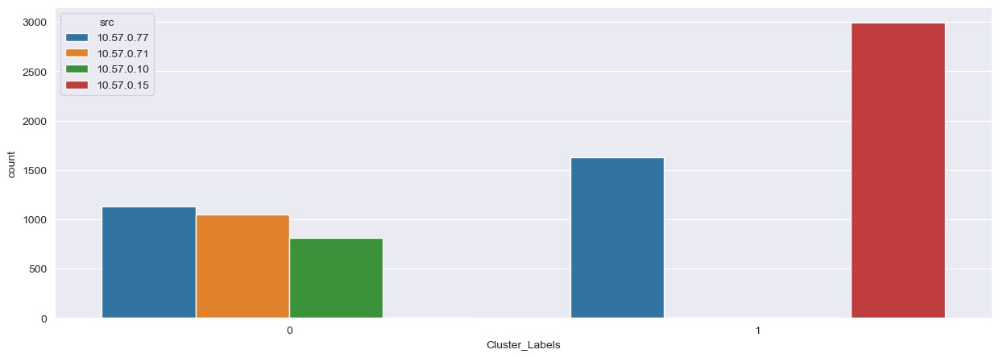

src_p


ValueError: Image size of 1233x78205 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 1500x500 with 1 Axes>

dst_p


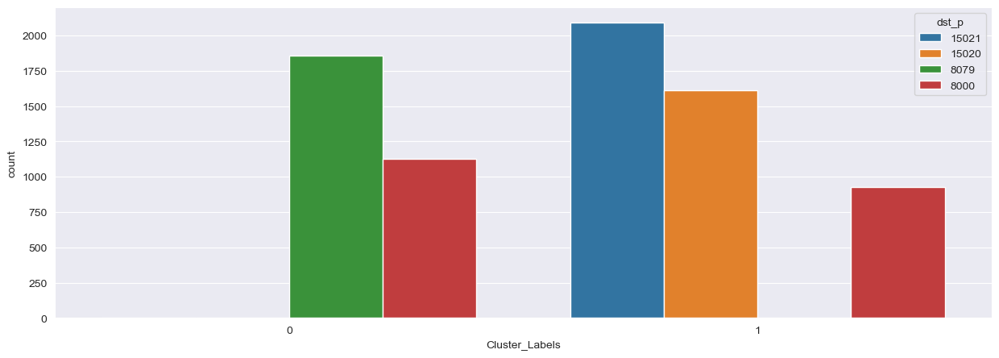

request_method


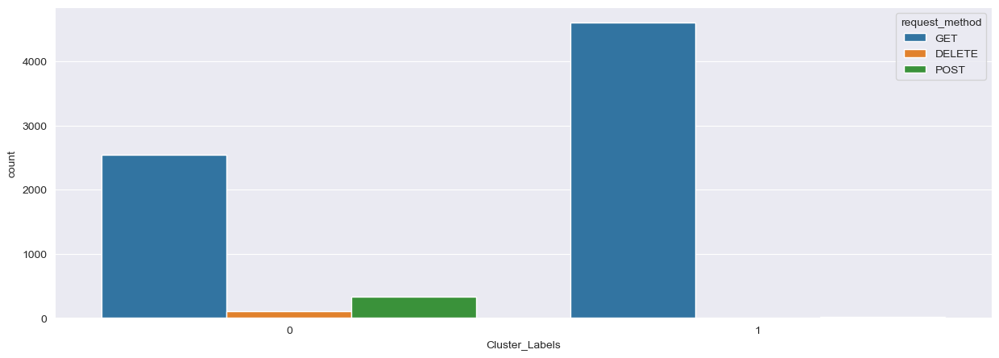

request_uri


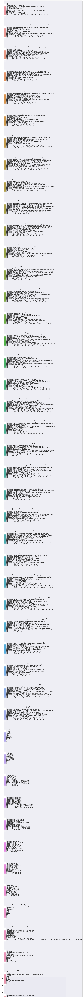

request_uri_query


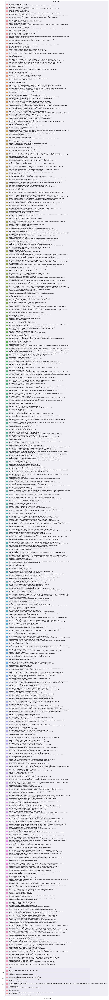

x_forwarded_for
user_agent


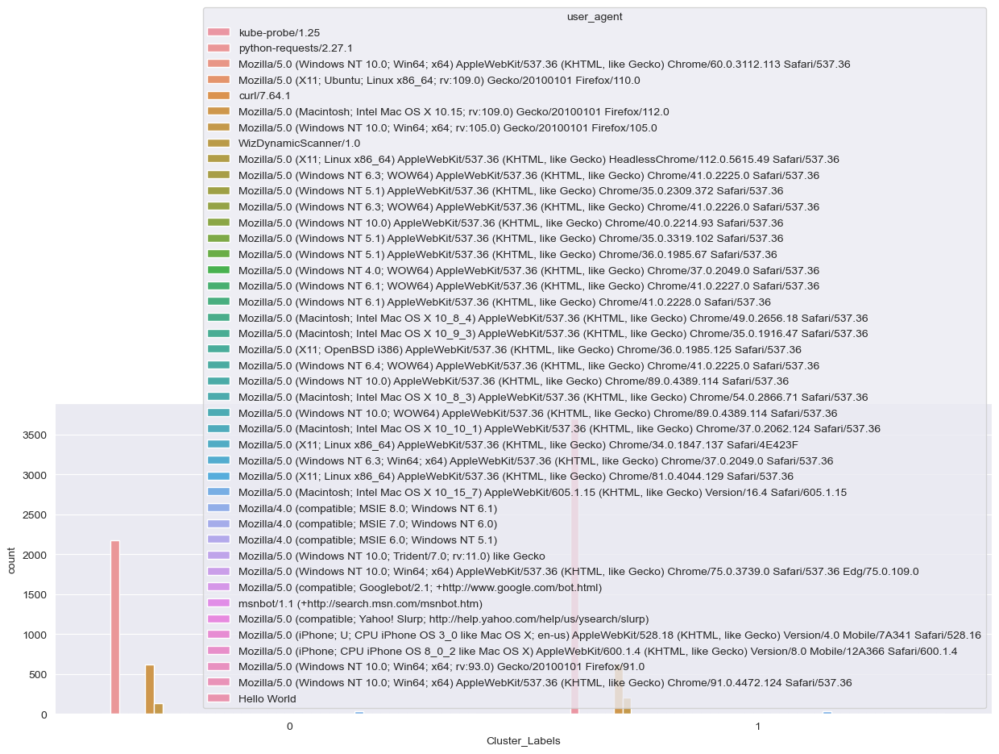

cookie


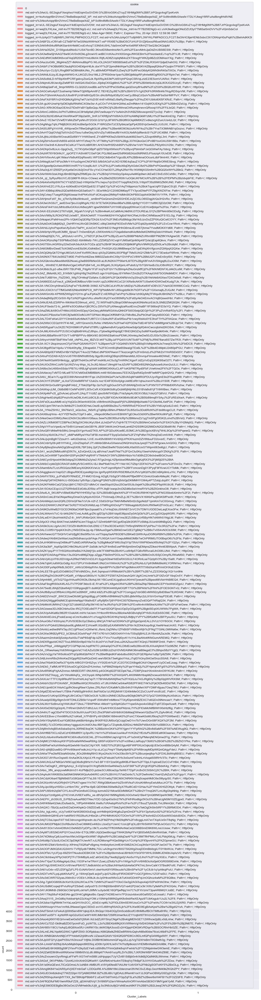

transfer_encoding


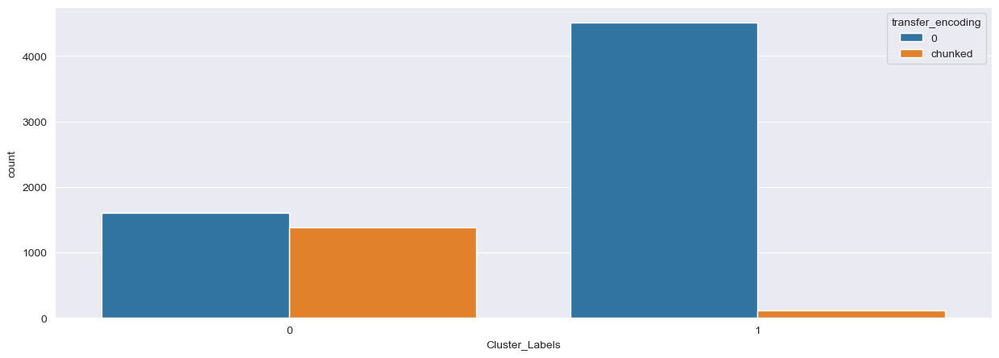

target


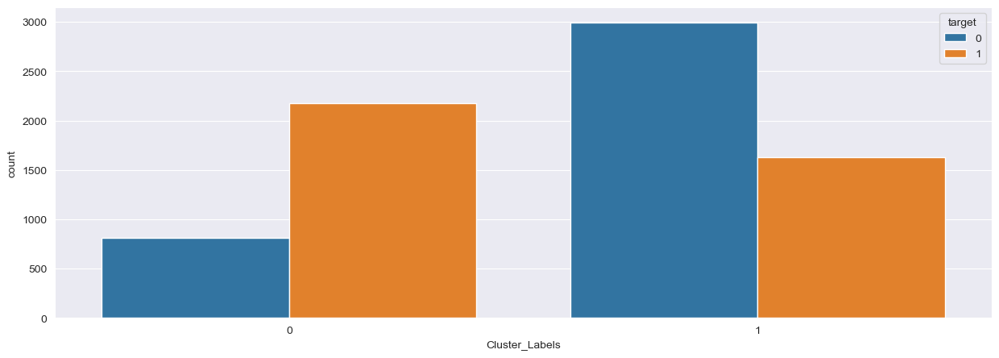

referer


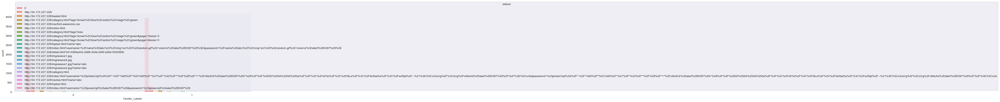

Cluster_Labels


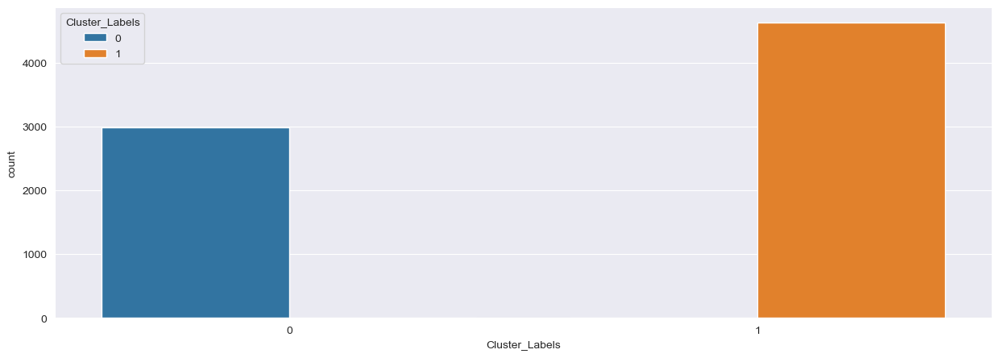

Segment


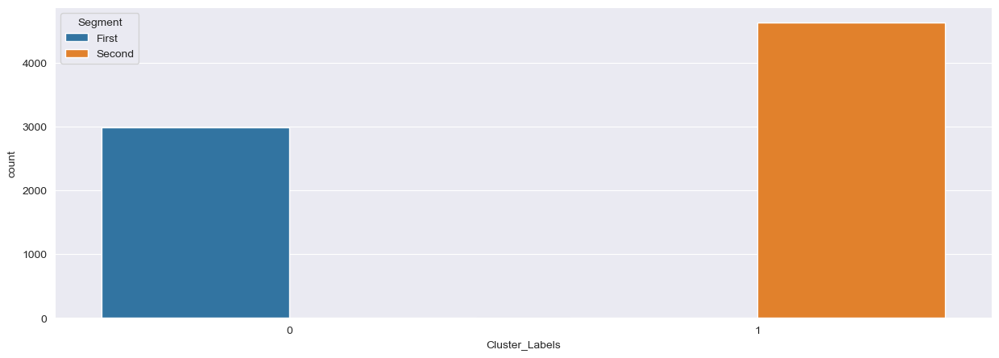

,response_code,response_line,cache_control,content_type,content_length,date,server,time,file_data,dst,...,request_uri,request_uri_query,x_forwarded_for,user_agent,cookie,transfer_encoding,target,referer,Cluster_Labels,Segment
7816,200,0,0,0,0,"Thu, 20 Apr 2023 14:31:04 GMT",envoy,0.000707,0,10.57.0.65,...,/healthz/ready,0,0,kube-probe/1.25,0,0,1,0,1,Second
7533,200,0,0,0,0,"Thu, 20 Apr 2023 14:29:02 GMT",0,0.001308,0,10.57.0.65,...,/app-health/ingress-controller/livez,0,0,kube-probe/1.25,0,0,1,0,1,Second
6735,200,0,0,0,0,"Thu, 20 Apr 2023 14:22:52 GMT",0,0.003218,0,10.57.0.65,...,/app-health/proxy/livez,0,0,kube-probe/1.25,0,0,1,0,1,Second
13838,200,0,0,0,0,"Thu, 20 Apr 2023 12:25:52 GMT",0,0.000903,0,10.57.0.65,...,/app-health/ingress-controller/livez,0,0,kube-probe/1.25,0,0,1,0,1,Second
6321,200,x-powered-by: Express,"public, max-age=0",application/json,10364,"Thu, 20 Apr 2023 14:19:41 GMT",istio-envoy,0.001607,"<!DOCTYPE html> <html lang=""en""> <head> ...",10.57.0.77,...,/detail.html?id=6d62d909-f957-430e-8689-b5129c...,id=6d62d909-f957-430e-8689-b5129c0bb75e,77.248.109.175,python-requests/2.27.1,md.sid=s%3AeUL-SE2sgiuFXeojAxoY4dEiqmGuGVDW.G%...,0,1,0,0,First
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3803,304,0,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000875,0,144.254.200.116,...,/css/owl.carousel.css,0,0,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,1,Second
3804,304,x-powered-by: Express,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000524,0,10.57.0.15,...,/css/custom.css,0,144.254.200.116,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,0,First
3805,304,0,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000739,0,144.254.200.116,...,/css/custom.css,0,0,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,1,Second
3806,304,x-powered-by: Express,"public, max-age=0",0,0,"Tue, 18 Apr 2023 11:38:39 GMT",istio-envoy,0.000818,0,10.57.0.15,...,/css/font-awesome.css,0,144.254.200.116,Mozilla/5.0 (Macintosh; Intel Mac OS X 10.15; ...,md.sid=s%3AKhfh0l4uf8RdKSar4AHfeMCvoEvfvcqT.53...,0,0,http://34.172.227.228/category.html?tags=brown...,0,First


In [93]:
categorical_feats = ['user_agent','response_line','cache_control', 'content_length','server','file_data','dst','src','src_p','dst_p','request_method','request_uri','request_uri_query','x_forwarded_for','user_agent','cookie','transfer_encoding','referer','authorization','authbasic','content_type','response_code','date']
numerical = ['time']
data_c = change_values(data, numerical,categorical_feats)
data_matrix = data_c.to_numpy()
clustering(data_matrix,data)

In [ ]:
def ML_results():
    pass

def heatmap():
    pass

def ROC():
    pass

def Metrics():
    pass


## 8.1 Best feature choices and why

## 8.2 Best feature encodings and why

# 9. Anomaly detection techniques 

In [25]:
def isolation_forest():
    pass

def decision_tree():
    pass



In [26]:
def Anomaly_results():
    pass

# 10. Deep learning techniques

In [27]:
def AAE():
    pass

def CNN():
    pass

def GNN():
    pass

In [28]:
def DL_results():
    pass

# low pass filter, for api call sequences. Before going through the data, maybe also interesting 
# removing health data maybe 
# print all the different categories for things as well sometime, to get a feel

also another ratio of abnormal / normal, use different ratios for testing

catboost
